In [1]:
import pandas as pd
import numpy as np
import os
import tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.metrics import average_precision_score, accuracy_score, precision_recall_curve, auc
from tensorflow.keras.applications import VGG16
from keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout
from IPython.display import FileLink
from tensorflow.keras.models import save_model
from tensorflow.keras import layers
from tensorflow.keras.models import load_model
import warnings
from google.colab import drive
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.applications.vgg16 import preprocess_input
from ast import literal_eval
from keras.preprocessing.image import load_img, img_to_array

SEED = 42
# Primary metric used to evaluate the perfomance
def AP(y_true, y_pred):
    return tf.py_function(average_precision_score, [y_true, y_pred], tf.float32)

def plot_images(image_paths, dims, figsize, image_labels):
    fig, axes = plt.subplots(dims[0], dims[1], figsize=figsize)

    for i, ax in enumerate(axes.flatten()):
        if i < len(image_paths):
            ax.imshow(mpimg.imread(image_paths[i]))
            ax.set_title(f"score: {image_labels[i]}")
            ax.axis('off')

    plt.tight_layout()
    plt.show()

# It gives warning when a batch does not have any positives which is quite often
warnings.filterwarnings("ignore", message="No positive class found in y_true, recall is set to one for all thresholds.")
np.random.seed(SEED)
tf.random.set_seed(SEED)

## Mounting Google Drive to load Dataset

In [2]:
# Mount Google Drive in order to get dataset
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# Copy the dataset from drive to colab enviornment
!cp '/content/drive/MyDrive/generated_data.zip' '/content/sample_data'

In [4]:
# Unzip dataset
!unzip -q '/content/sample_data/generated_data.zip' -d '/content/sample_data/Original+GeneratedDATA'

## Loading Dataset

In [5]:
labels = ['aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
          'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse',
          'motorbike', 'person', 'pottedplant', 'sheep',
          'sofa', 'train', 'tvmonitor']

In [6]:
# loading csv files for original and reconstructed dataset
original_data = pd.read_csv('/content/drive/MyDrive/dataset.csv')

# this csv file contains 640 reconstructed images; 32 for each label
reconstructed_32_df = pd.read_csv('/content/drive/MyDrive/generated_data.csv')

In [7]:
for i in range(len(original_data)):
  original_data['target'][i] = literal_eval(original_data['target'][i])

for i in range(len(reconstructed_32_df)):
  reconstructed_32_df['target'][i] = literal_eval(reconstructed_32_df['target'][i])

In [8]:
reconstructed_32_df['target'] = reconstructed_32_df['target'].apply(lambda x: x[0])

In [9]:
# creating dataframe for 10 samples and 25 samples
reconstructed_25_df = pd.DataFrame(columns=reconstructed_32_df.columns)
reconstructed_10_df = pd.DataFrame(columns=reconstructed_32_df.columns)

# Iterate over each label
for label in reconstructed_32_df['target'].unique():
    # Select 25 random images for the current label
    label_subset = reconstructed_32_df[reconstructed_32_df['target'] == label].sample(n=25, random_state=42)
    # Select 10 random images for the current label
    label_10_subset = reconstructed_32_df[reconstructed_32_df['target'] == label].sample(n=10, random_state=42)
    # Append both subsets to the new DataFrame
    reconstructed_25_df = pd.concat([reconstructed_25_df, label_subset], ignore_index=True)
    reconstructed_10_df = pd.concat([reconstructed_10_df, label_10_subset], ignore_index=True)

In [10]:
# saving as csv files
reconstructed_25_df.to_csv('reconstructed_25_df.csv', index=False)
reconstructed_10_df.to_csv('reconstructed_10_df.csv', index=False)

In [11]:
IMAGES_DIR = '/content/sample_data/Original+GeneratedDATA/generated'

In [12]:
# Original Dataset
original_data

,id,set,target
0,2008_000008.jpg,train,"[horse, person]"
1,2008_000015.jpg,train,"[bottle, bottle]"
2,2008_000019.jpg,train,"[dog, dog, dog]"
3,2008_000023.jpg,train,"[tvmonitor, bottle, person, person, person]"
4,2008_000028.jpg,train,"[car, car]"
...,...,...,...
4327,2008_008755.jpg,val,"[person, person, bicycle]"
4328,2008_008758.jpg,val,"[bicycle, person]"
4329,2008_008765.jpg,val,[aeroplane]
4330,2008_008767.jpg,val,[train]


In [24]:
# Dataset of 32 Reconstructed Images from VAE
reconstructed_32_df

,id,set,target
0,image_411.jpg,train,motorbike
1,image_408.jpg,train,motorbike
2,image_413.jpg,train,motorbike
3,image_404.jpg,train,motorbike
4,image_388.jpg,train,motorbike
...,...,...,...
635,generated_0_27.jpg,train,cat
636,generated_0_2.jpg,train,cat
637,generated_0_6.jpg,train,cat
638,generated_0_21.jpg,train,cat


In [25]:
# Dataset of 25 Reconstructed Images from VAE
reconstructed_25_df

,id,set,target
0,image_415.jpg,train,motorbike
1,image_394.jpg,train,motorbike
2,image_409.jpg,train,motorbike
3,image_389.jpg,train,motorbike
4,image_396.jpg,train,motorbike
...,...,...,...
495,generated_0_4.jpg,train,cat
496,generated_0_27.jpg,train,cat
497,generated_0_1.jpg,train,cat
498,generated_0_11.jpg,train,cat


In [26]:
# Dataset of 10 Reconstructed Images from VAE
reconstructed_10_df

,id,set,target
0,image_415.jpg,train,motorbike
1,image_394.jpg,train,motorbike
2,image_409.jpg,train,motorbike
3,image_389.jpg,train,motorbike
4,image_396.jpg,train,motorbike
...,...,...,...
195,generated_0_5.jpg,train,cat
196,generated_0_21.jpg,train,cat
197,generated_0_17.jpg,train,cat
198,generated_0_12.jpg,train,cat


## Model class to represent each label

In [14]:
def Model():
    OPTIMIZER = 'Adam'
    LOSS = 'binary_crossentropy'
    INPUT_SHAPE = (224, 224, 3)
    base_model = VGG16(weights='imagenet', include_top=False, input_shape=INPUT_SHAPE)

    for layer in base_model.layers:
        layer.trainable = False

    model = Sequential([
        base_model,
        GlobalAveragePooling2D(),
        Dense(128, activation='relu'),
        Dropout(0.5),
        Dense(1, activation='sigmoid')
    ])

    model.compile(
        optimizer=OPTIMIZER,
        loss=LOSS,
        metrics=[AP],
    )

    return model

## Defining Data Generator

In [15]:
def create_data_generators(df, label, batch_size = 32):
    target_size = (224, 224)

    df[label] = df['target'].apply(lambda x: 1 if label in x else 0)

    datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )

    train_generator = datagen.flow_from_dataframe(
        directory=IMAGES_DIR,
        dataframe=df[df['set'] == 'train'],
        x_col='id',
        y_col=label,
        batch_size=batch_size,
        target_size=target_size,
        class_mode='raw',
        shuffle=True,
    )

    validation_generator = datagen.flow_from_dataframe(
        directory=IMAGES_DIR,
        dataframe=df[df['set'] == 'val'],
        x_col='id',
        y_col=label,
        batch_size=batch_size,
        target_size=target_size,
        class_mode='raw',
        shuffle=False,
    )

    return train_generator, validation_generator

## Training after adding 10 reconstructed images per class

In [ ]:
# Define constants and settings
OUT_MODELS_PATH = '/content/drive/MyDrive/saved_10_models'
EPOCHS = 5
BATCH_SIZE = 32
PATIENCE = 7
MIN_DELTA = 0.01
TARGET_SIZE = (224, 224, 3)

os.makedirs(OUT_MODELS_PATH, exist_ok=True)

for label in labels:
    print("training", label)

    model = Model()

    ''' For each label a copy of original dataframe will be created in which 10 reconstructed images
        will be added of that label in order to train Vgg.
    '''
    df_copy = original_data.copy()
    for index, row in reconstructed_10_df.iterrows():
        if label in row['target']:
            row_dict = dict(row)
            row_dict['target'] = [row_dict['target']]
            new_df = pd.DataFrame(row_dict)
            df_copy = pd.concat([df_copy, new_df], ignore_index=True)

    train_gen, val_gen = create_data_generators(df_copy, label)

    early_stopping = EarlyStopping(
        monitor='val_AP',
        min_delta=MIN_DELTA,
        patience=PATIENCE,
        verbose=1,
        mode='max',
        restore_best_weights=True,
        start_from_epoch=2
    )

    model.fit(
        train_gen,
        epochs=EPOCHS,
        validation_data=val_gen,
        callbacks=[early_stopping]
    )

    model.save(os.path.join(OUT_MODELS_PATH, f"{label}.keras"))

training aeroplane
Found 2121 validated image filenames.
Found 2221 validated image filenames.
Epoch 1/5
67/67 [==============================] - 28s 403ms/step - loss: 0.4287 - AP: 0.5627 - val_loss: 0.0794 - val_AP: 0.6743
Epoch 2/5
67/67 [==============================] - 26s 386ms/step - loss: 0.0951 - AP: 0.7119 - val_loss: 0.0688 - val_AP: 0.6802
Epoch 3/5
67/67 [==============================] - 25s 381ms/step - loss: 0.0663 - AP: 0.8417 - val_loss: 0.0737 - val_AP: 0.6832
Epoch 4/5
67/67 [==============================] - 26s 396ms/step - loss: 0.0299 - AP: 0.8496 - val_loss: 0.0607 - val_AP: 0.6911
Epoch 5/5
67/67 [==============================] - 26s 386ms/step - loss: 0.0254 - AP: 0.8445 - val_loss: 0.0535 - val_AP: 0.6960
training bicycle
Found 2121 validated image filenames.
Found 2221 validated image filenames.
Epoch 1/5
67/67 [==============================] - 28s 388ms/step - loss: 0.7692 - AP: 0.3486 - val_loss: 0.1938 - val_AP: 0.5170
Epoch 2/5
67/67 [===============

## Evaluating Performance, and Drawing Curves after adding 10 reconstructed images from VAE

In [16]:
OUT_MODELS_PATH = '/content/drive/MyDrive/saved_10_models'
THRESHOLD = 0.5
metrics = []
for _label in os.listdir(OUT_MODELS_PATH):
    label = _label.removesuffix('.keras')
    _, val_gen = create_data_generators(original_data, label)
    model = load_model(os.path.join(OUT_MODELS_PATH, f"{label}.keras"))

    y_pred = model.predict(val_gen)
    p, r, _ = precision_recall_curve(val_gen.labels, y_pred)
    _auc = auc(r, p)
    metric = {'pr' : (p, r), 'auc' : _auc, 'label' : label }
    metrics.append(metric)

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 21s 180ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 9s 124ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 10s 139ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 10s 137ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 11s 146ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 9s 125ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 10s 141ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70

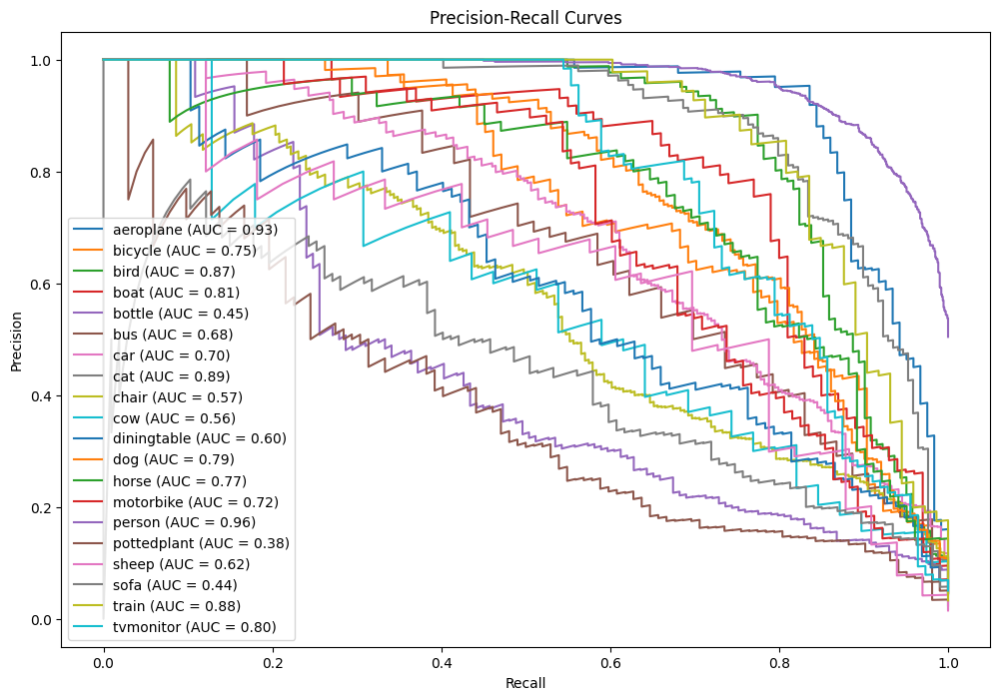

In [17]:
plt.figure(figsize=(12, 8))  # Adjust the size as needed
for metric in metrics:
    p, r = metric['pr']
    _auc = metric['auc']
    label = metric['label']

    # Plot precision-recall curve
    plt.plot(r, p, label=f'{label} (AUC = {_auc:.2f})')

# Set plot labels and title
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curves')
plt.legend()

# Show the plot
plt.savefig(f'combined_curves.png', dpi=300, bbox_inches='tight')
plt.show()

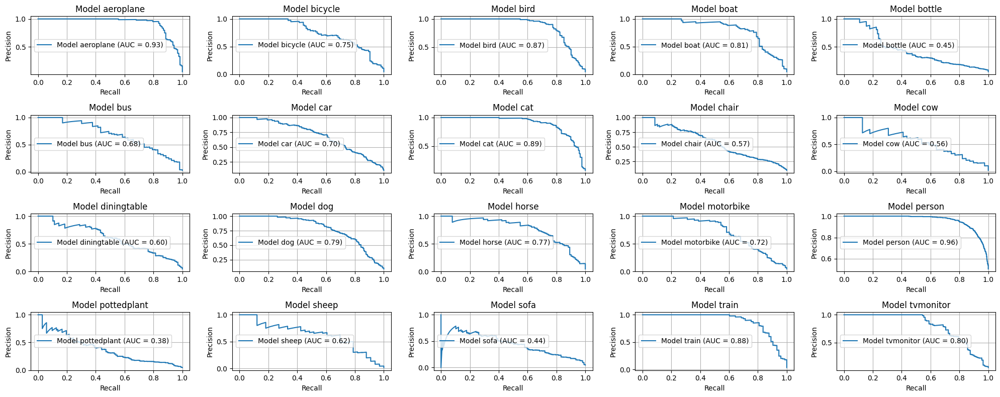

In [18]:
fig, axs = plt.subplots(4, 5, figsize=(20, 8))
# Flatten the axs array for easy iteration
axs = axs.flatten()

for i, metric in enumerate(metrics):
    p, r = metric['pr']
    auc = metric['auc']
    label = metric['label']

    # Determine the subplot position
    row = i // 5
    col = i % 5

    # Plot on the specified subplot
    axs[i].plot(r, p, label=f'Model {label} (AUC = {auc:.2f})')
    axs[i].set_xlabel('Recall')
    axs[i].set_ylabel('Precision')
    axs[i].set_title(f'Model {label}')
    axs[i].legend(loc='center left')
    axs[i].grid(True)

plt.tight_layout()

# Show the plots
plt.savefig(f'individual_curves.png', dpi=300, bbox_inches='tight')
plt.show()

In [19]:
print("mAP", np.mean([item['auc'] for item in metrics]))

mAP 0.708544961446701



## Training after adding 25 reconstructed images per class

In [ ]:
# Define constants and settings
OUT_MODELS_PATH = '/content/drive/MyDrive/Models'
EPOCHS = 5
BATCH_SIZE = 32
PATIENCE = 7
MIN_DELTA = 0.01
TARGET_SIZE = (224, 224, 3)

os.makedirs(OUT_MODELS_PATH, exist_ok=True)

for label in labels:
    print("training", label)

    model = Model()

    ''' For each label a copy of original dataframe will be created in which 25 reconstructed images
        will be added of that label in order to train Vgg.
    '''
    df_copy = original_data.copy()
    for index, row in reconstructed_25_df.iterrows():
        if label in row['target']:
            row_dict = dict(row)
            row_dict['target'] = [row_dict['target']]
            new_df = pd.DataFrame(row_dict)
            df_copy = pd.concat([df_copy, new_df], ignore_index=True)

    train_gen, val_gen = create_data_generators(df_copy, label)

    early_stopping = EarlyStopping(
        monitor='val_AP',
        min_delta=MIN_DELTA,
        patience=PATIENCE,
        verbose=1,
        mode='max',
        restore_best_weights=True,
        start_from_epoch=2
    )

    model.fit(
        train_gen,
        epochs=EPOCHS,
        validation_data=val_gen,
        callbacks=[early_stopping]
    )

    model.save(os.path.join(OUT_MODELS_PATH, f"{label}.keras"))

training aeroplane
58889256/58889256 [==============================] - 3s 0us/step
Found 2136 validated image filenames.
Found 2221 validated image filenames.
Epoch 1/5
67/67 [==============================] - 50s 563ms/step - loss: 0.2650 - AP: 0.6511 - val_loss: 0.0759 - val_AP: 0.6932
Epoch 2/5
67/67 [==============================] - 26s 395ms/step - loss: 0.0649 - AP: 0.8237 - val_loss: 0.0705 - val_AP: 0.7031
Epoch 3/5
67/67 [==============================] - 26s 387ms/step - loss: 0.0601 - AP: 0.8488 - val_loss: 0.0620 - val_AP: 0.6974
Epoch 4/5
67/67 [==============================] - 27s 400ms/step - loss: 0.0363 - AP: 0.9007 - val_loss: 0.0542 - val_AP: 0.6974
Epoch 5/5
67/67 [==============================] - 26s 385ms/step - loss: 0.0229 - AP: 0.8806 - val_loss: 0.0769 - val_AP: 0.6954
training bicycle
Found 2136 validated image filenames.
Found 2221 validated image filenames.
Epoch 1/5
67/67 [==============================] - 27s 389ms/step - loss: 0.5731 - AP: 0.4400 - v

## Evaluating Performance, and Drawing Curves after adding 25 reconstructed images from VAE

In [ ]:
OUT_MODELS_PATH = '/content/drive/MyDrive/Models'
THRESHOLD = 0.5
metrics = []
for _label in os.listdir(OUT_MODELS_PATH):
    label = _label.removesuffix('.keras')
    _, val_gen = create_data_generators(original_data, label)
    model = load_model(os.path.join(OUT_MODELS_PATH, f"{label}.keras"))

    y_pred = model.predict(val_gen)
    p, r, _ = precision_recall_curve(val_gen.labels, y_pred)
    _auc = auc(r, p)
    metric = {'pr' : (p, r), 'auc' : _auc, 'label' : label }
    metrics.append(metric)

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 21s 183ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 9s 122ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 11s 148ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 10s 140ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 10s 141ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 9s 124ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 10s 134ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70

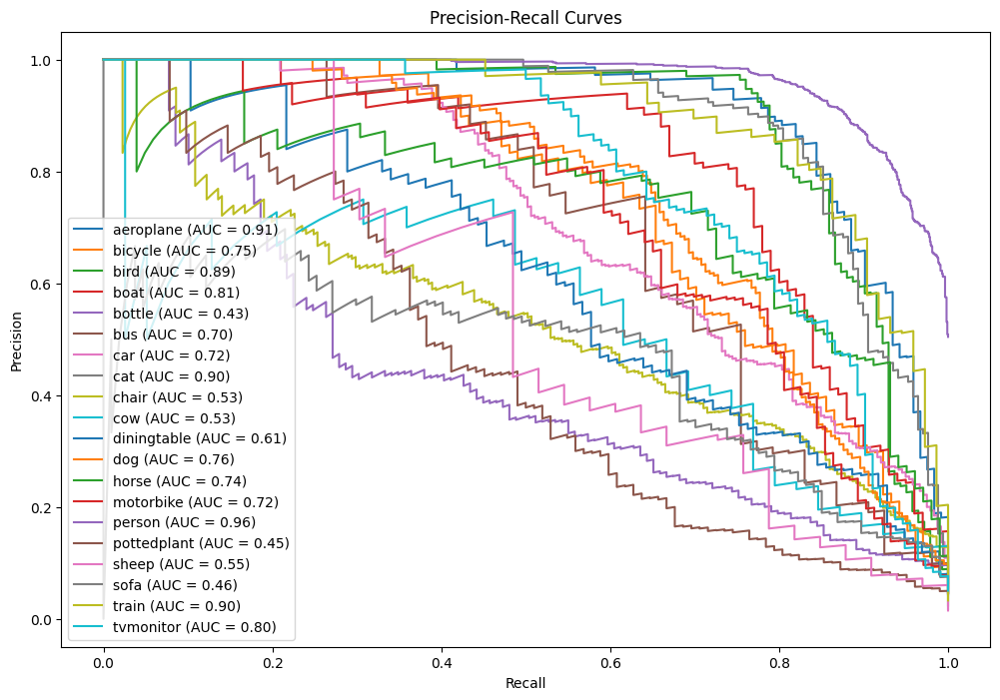

In [ ]:
plt.figure(figsize=(12, 8))  # Adjust the size as needed
for metric in metrics:
    p, r = metric['pr']
    _auc = metric['auc']
    label = metric['label']

    # Plot precision-recall curve
    plt.plot(r, p, label=f'{label} (AUC = {_auc:.2f})')

# Set plot labels and title
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curves')
plt.legend()

# Show the plot
plt.savefig(f'combined_curves.png', dpi=300, bbox_inches='tight')
plt.show()

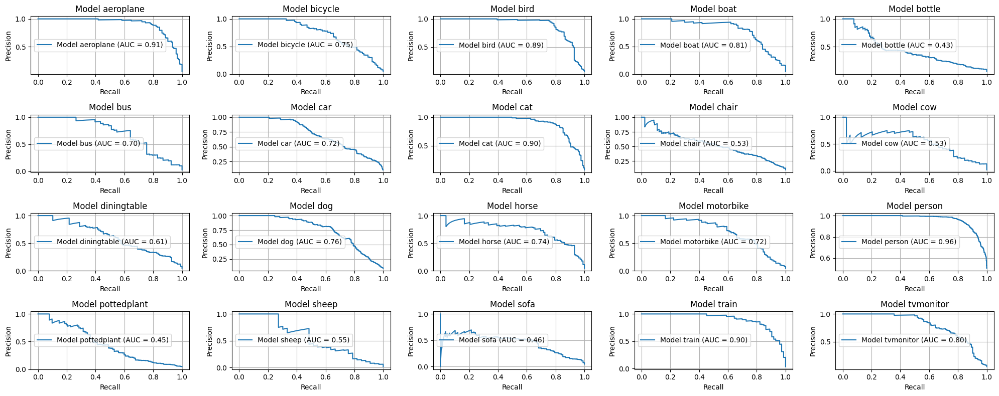

In [ ]:
fig, axs = plt.subplots(4, 5, figsize=(20, 8))
# Flatten the axs array for easy iteration
axs = axs.flatten()

for i, metric in enumerate(metrics):
    p, r = metric['pr']
    auc = metric['auc']
    label = metric['label']

    # Determine the subplot position
    row = i // 5
    col = i % 5

    # Plot on the specified subplot
    axs[i].plot(r, p, label=f'Model {label} (AUC = {auc:.2f})')
    axs[i].set_xlabel('Recall')
    axs[i].set_ylabel('Precision')
    axs[i].set_title(f'Model {label}')
    axs[i].legend(loc='center left')
    axs[i].grid(True)

plt.tight_layout()

# Show the plots
plt.savefig(f'individual_curves.png', dpi=300, bbox_inches='tight')
plt.show()

## Mean Average Precision

In [ ]:
print("mAP", np.mean([item['auc'] for item in metrics]))

mAP 0.7059635476589321


## Top 10 Confident Images of Each Model

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 10s 140ms/step


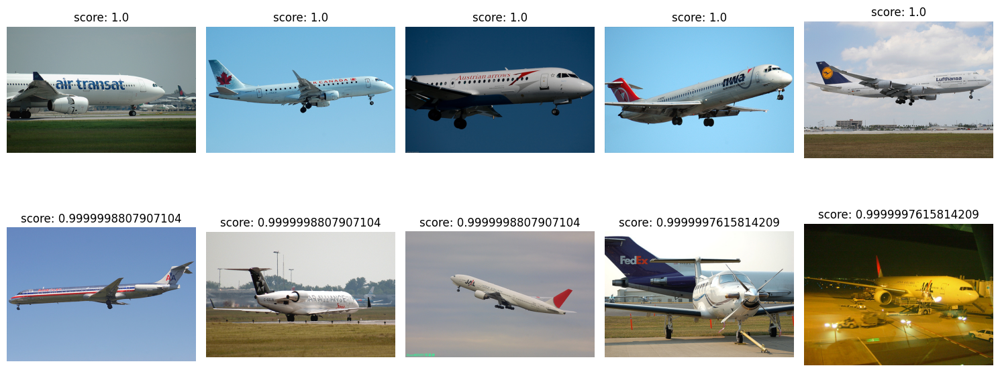

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 10s 146ms/step


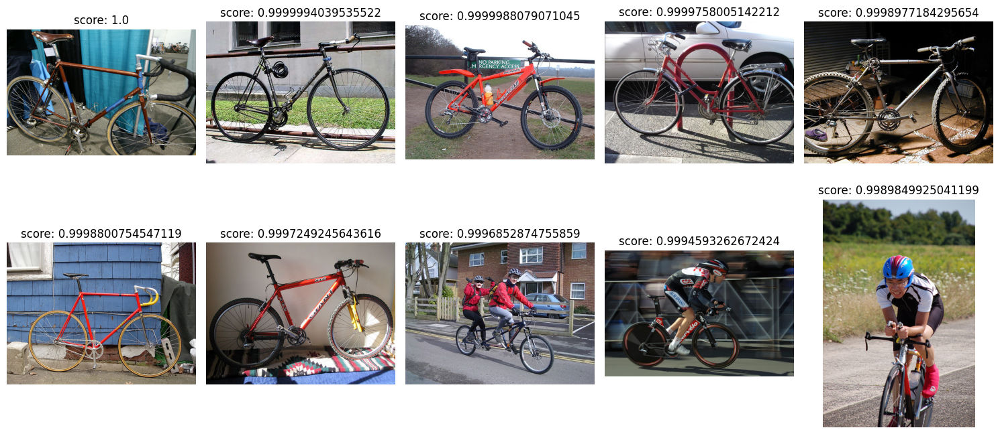

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 11s 152ms/step


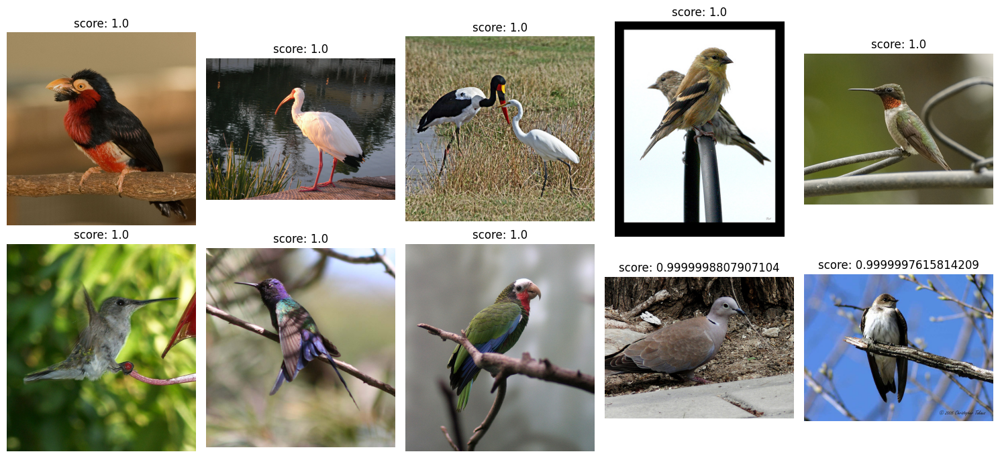

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 13s 191ms/step


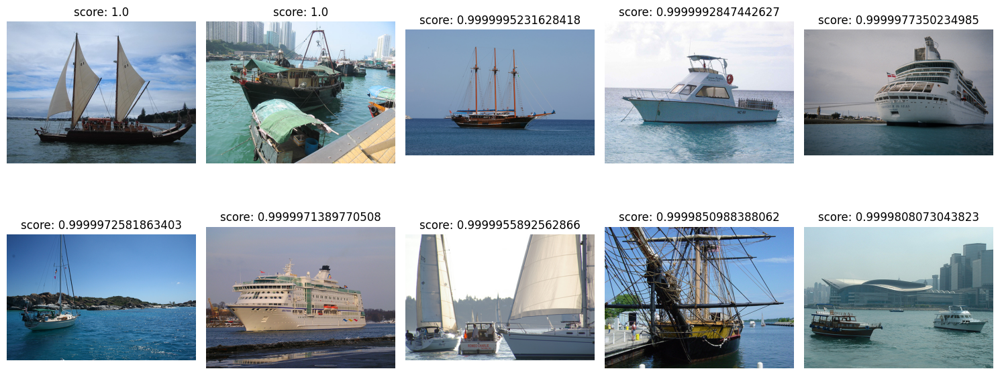

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 12s 170ms/step


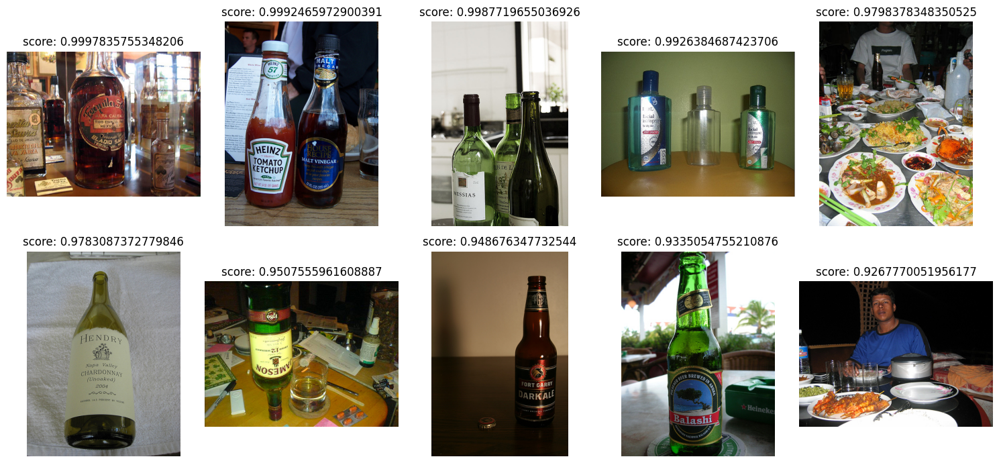

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 13s 178ms/step


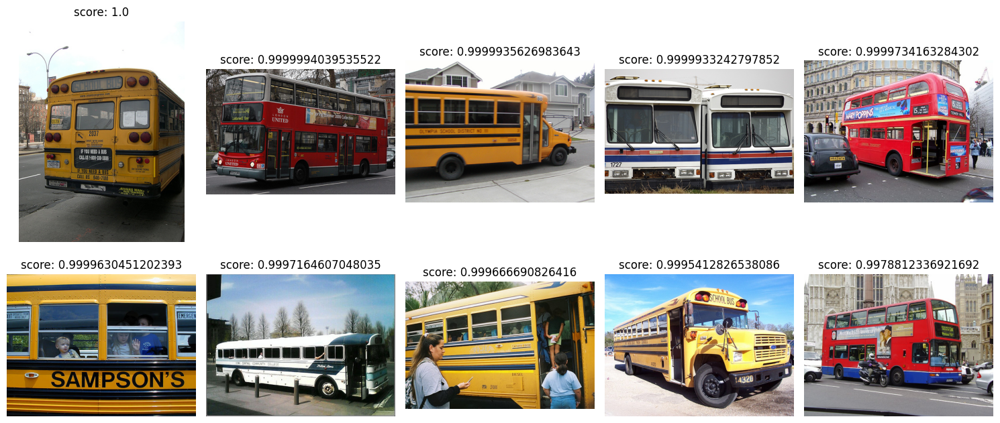

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 13s 187ms/step


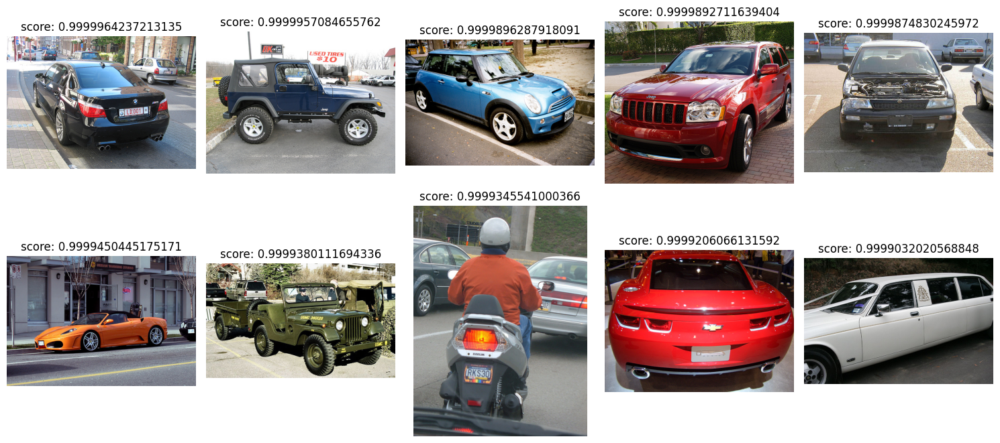

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 14s 193ms/step


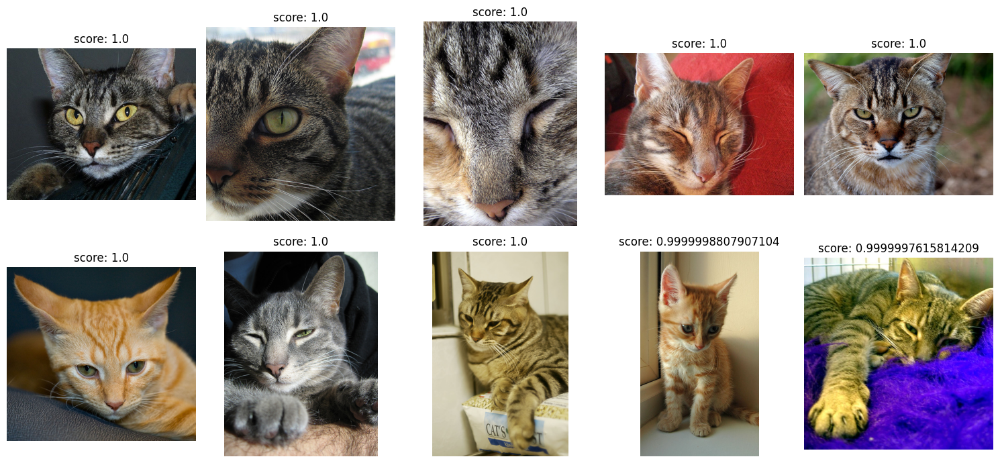

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 14s 194ms/step


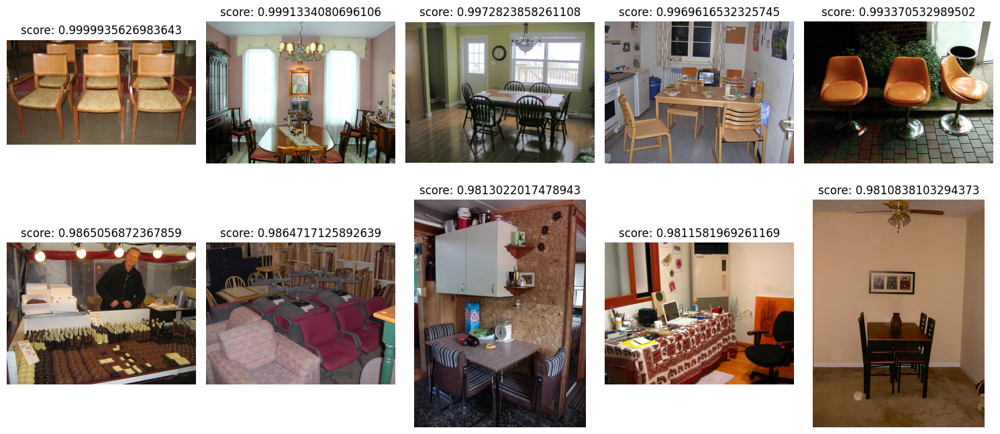

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 14s 198ms/step


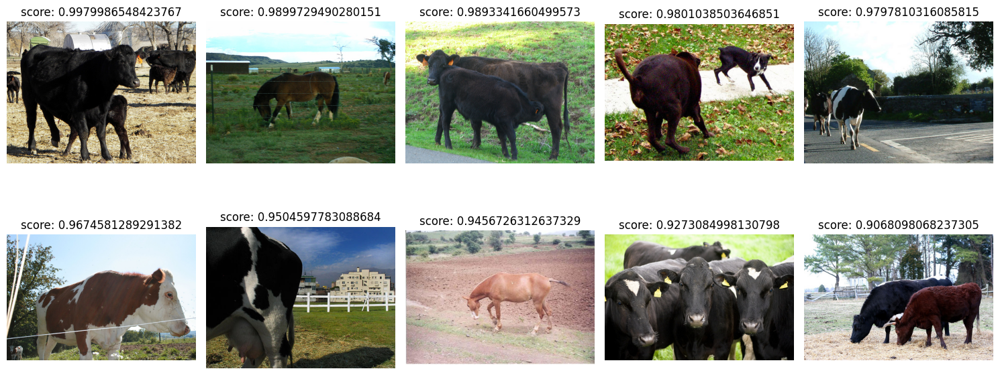

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 14s 195ms/step


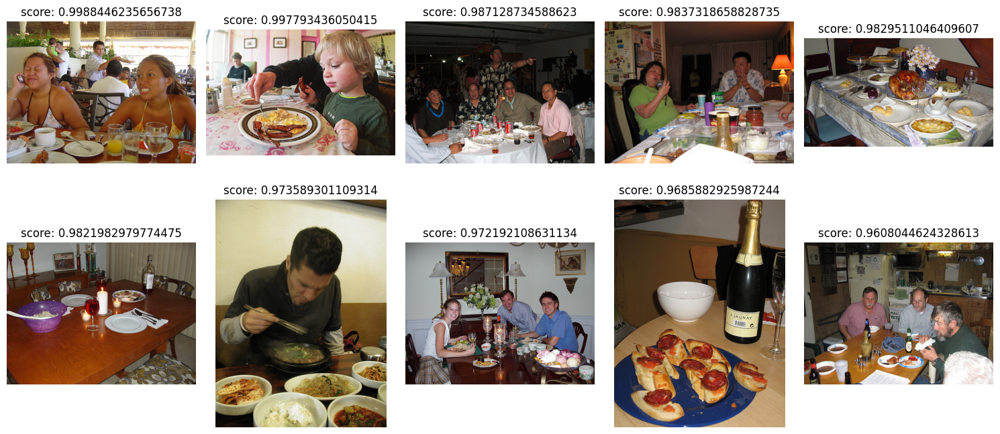

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 14s 200ms/step


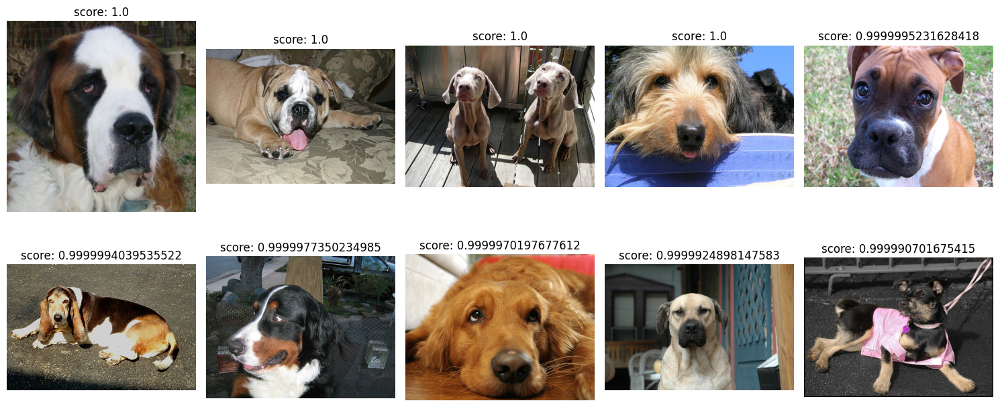

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 14s 203ms/step


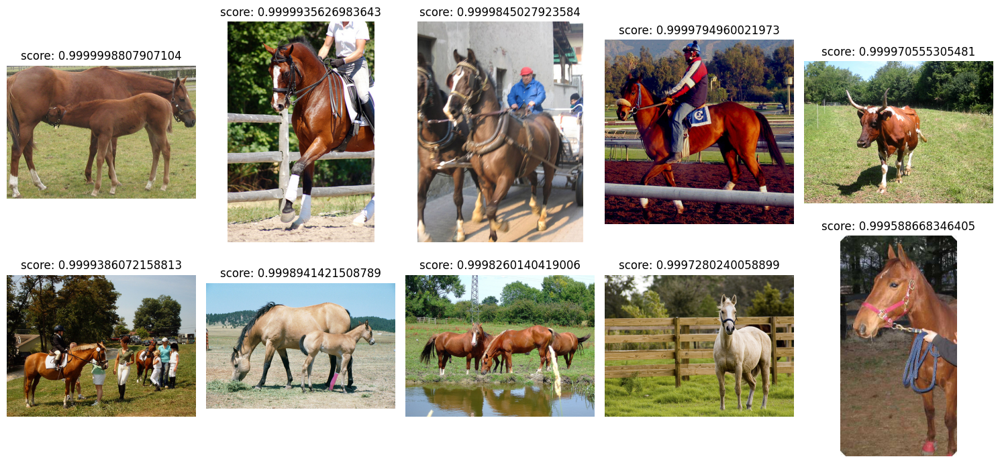

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 14s 195ms/step


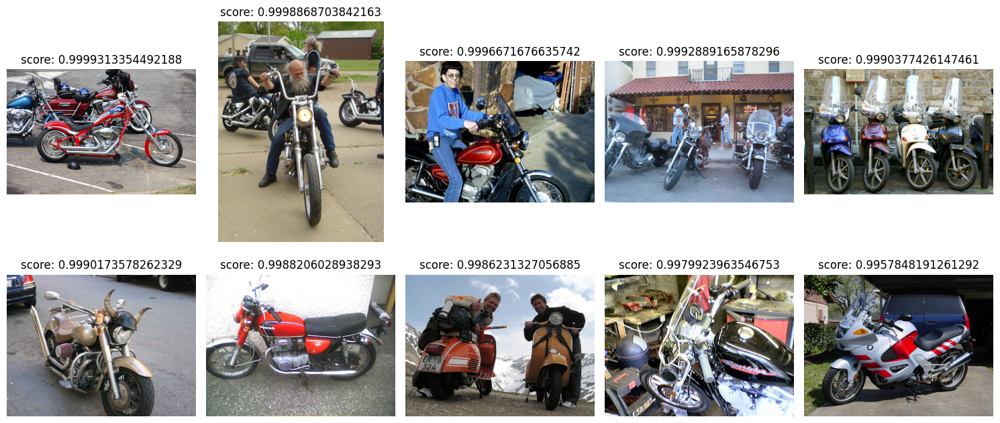

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 14s 195ms/step


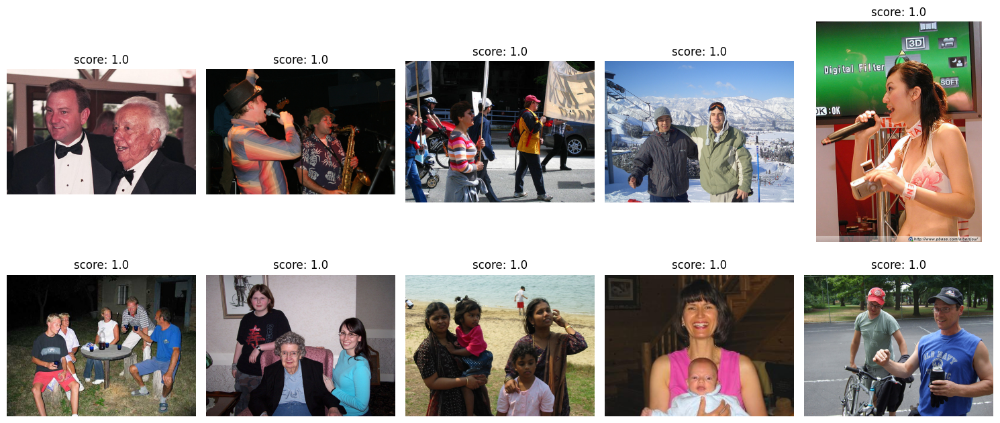

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 14s 196ms/step


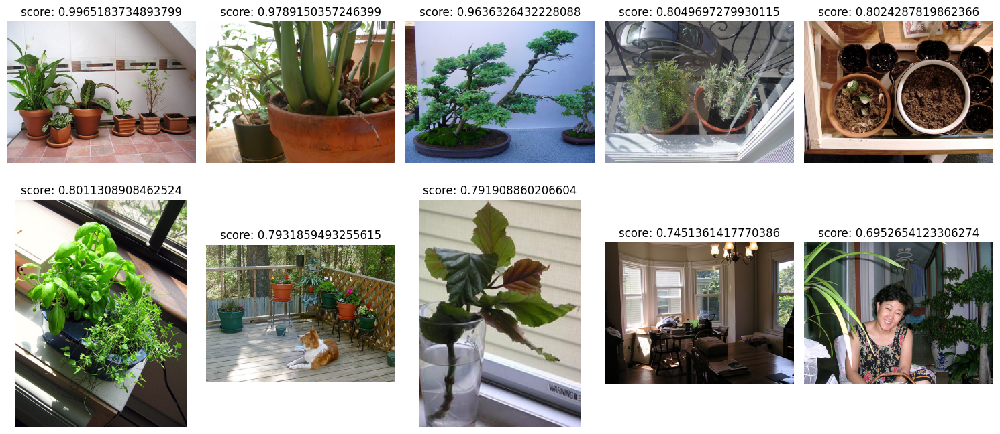

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 14s 200ms/step


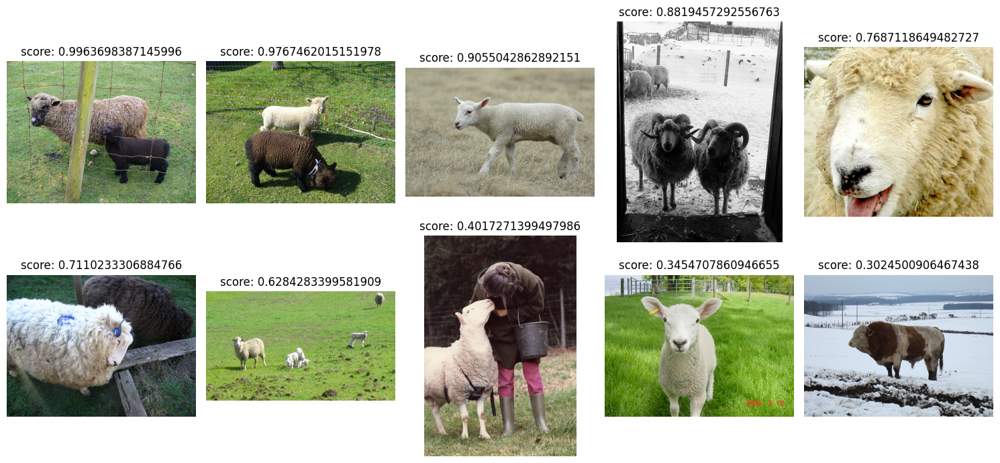

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 14s 196ms/step


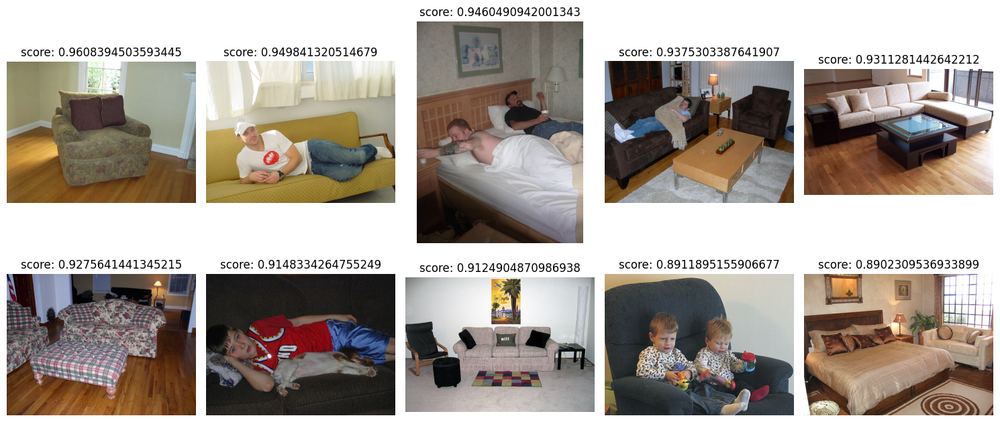

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 14s 192ms/step


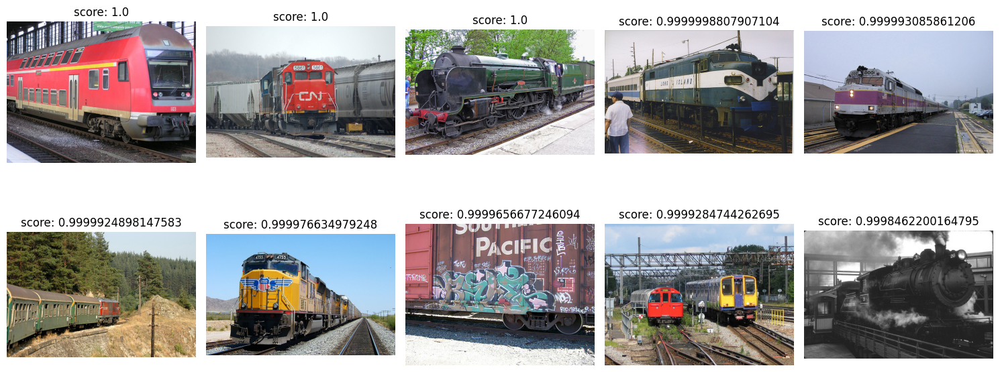

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 14s 191ms/step


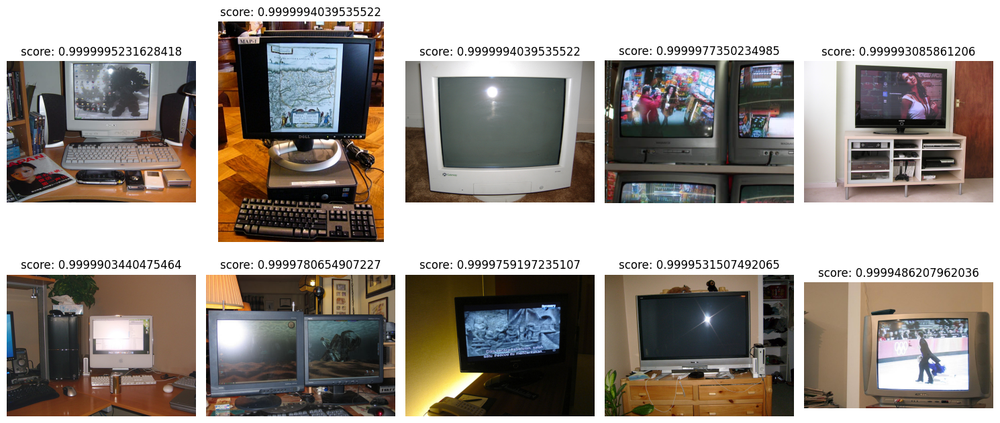

In [ ]:
for label in labels:
  # Load your trained TensorFlow model
  model = load_model(os.path.join(OUT_MODELS_PATH, f"{label}.keras"))
  _, val_gen = create_data_generators(original_data, label)

  # Make predictions on the test set
  predictions = model.predict(val_gen)[:, 0]
  sorted_indices = np.argsort(predictions)[::-1][:10]
  images = np.array(val_gen.filepaths)[sorted_indices]
  plot_images(images, dims=(2, 5), figsize=(15, 7), image_labels=predictions[sorted_indices])

## Training after adding 32 images per class

In [22]:
# Define constants and settings
OUT_MODELS_PATH = '/content/drive/MyDrive/Models1'
EPOCHS = 5
BATCH_SIZE = 32
PATIENCE = 7
MIN_DELTA = 0.01
TARGET_SIZE = (224, 224, 3)

os.makedirs(OUT_MODELS_PATH, exist_ok=True)

for label in labels:
    print("training", label)

    model = Model()

    ''' For each label a copy of original dataframe will be created in which 32 reconstructed images
        will be added of that label in order to train Vgg.
    '''
    df_copy = original_data.copy()
    for index, row in reconstructed_32_df.iterrows():
        if label in row['target']:
            row_dict = dict(row)
            row_dict['target'] = [row_dict['target']]
            new_df = pd.DataFrame(row_dict)
            df_copy = pd.concat([df_copy, new_df], ignore_index=True)

    train_gen, val_gen = create_data_generators(df_copy, label)

    early_stopping = EarlyStopping(
        monitor='val_AP',
        min_delta=MIN_DELTA,
        patience=PATIENCE,
        verbose=1,
        mode='max',
        restore_best_weights=True,
        start_from_epoch=2
    )

    model.fit(
        train_gen,
        epochs=EPOCHS,
        validation_data=val_gen,
        callbacks=[early_stopping]
    )

    model.save(os.path.join(OUT_MODELS_PATH, f"{label}.keras"))

training aeroplane
58889256/58889256 [==============================] - 0s 0us/step
Found 2143 validated image filenames.
Found 2221 validated image filenames.
Epoch 1/5
67/67 [==============================] - 34s 463ms/step - loss: 0.4321 - AP: 0.6362 - val_loss: 0.0765 - val_AP: 0.6864
Epoch 2/5
67/67 [==============================] - 32s 487ms/step - loss: 0.0841 - AP: 0.8746 - val_loss: 0.0602 - val_AP: 0.6983
Epoch 3/5
67/67 [==============================] - 24s 356ms/step - loss: 0.0650 - AP: 0.8117 - val_loss: 0.0883 - val_AP: 0.6888
Epoch 4/5
67/67 [==============================] - 25s 373ms/step - loss: 0.0447 - AP: 0.8686 - val_loss: 0.0572 - val_AP: 0.6941
Epoch 5/5
67/67 [==============================] - 24s 356ms/step - loss: 0.0230 - AP: 0.8988 - val_loss: 0.0588 - val_AP: 0.6981
training bicycle
Found 2143 validated image filenames.
Found 2221 validated image filenames.
Epoch 1/5
67/67 [==============================] - 26s 367ms/step - loss: 0.4749 - AP: 0.4823 - v

## Evaluating Performance, and Drawing Curves after adding 32 reconstructed images from VAE

In [ ]:
OUT_MODELS_PATH = '/content/drive/MyDrive/Models1'
THRESHOLD = 0.5
metrics = []
for _label in os.listdir(OUT_MODELS_PATH):
    label = _label.removesuffix('.keras')
    _, val_gen = create_data_generators(original_data, label)
    model = load_model(os.path.join(OUT_MODELS_PATH, f"{label}.keras"))

    y_pred = model.predict(val_gen)
    p, r, _ = precision_recall_curve(val_gen.labels, y_pred)
    _auc = auc(r, p)
    metric = {'pr' : (p, r), 'auc' : _auc, 'label' : label }
    metrics.append(metric)

Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 10s 138ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 10s 140ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 10s 140ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 9s 125ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 9s 128ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 10s 137ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70/70 [==============================] - 10s 136ms/step
Found 2111 validated image filenames.
Found 2221 validated image filenames.
70

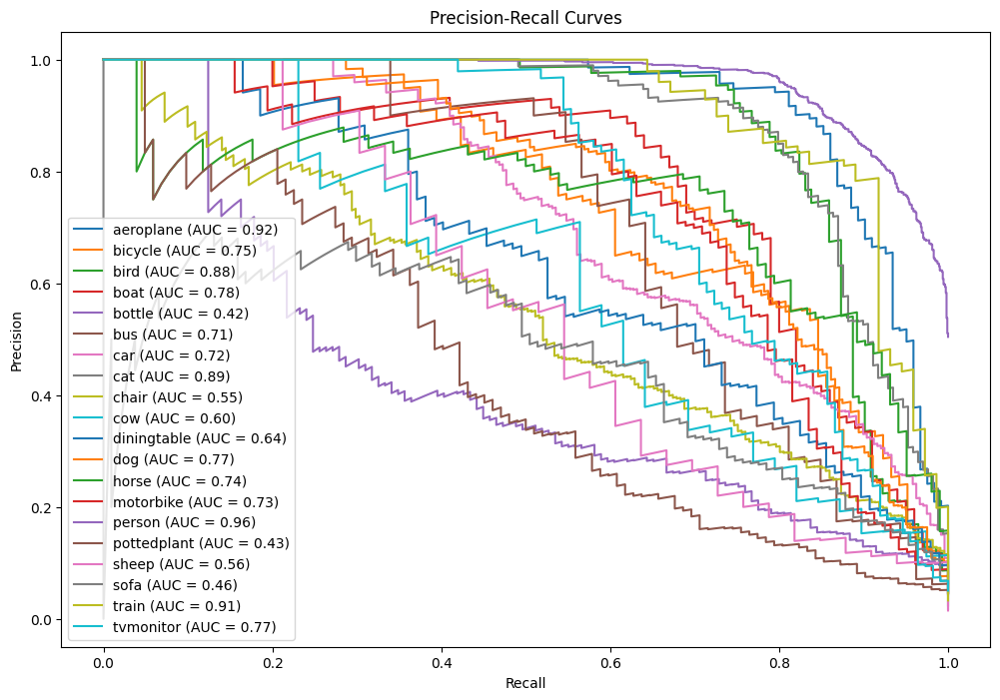

In [ ]:
plt.figure(figsize=(12, 8))  # Adjust the size as needed
for metric in metrics:
    p, r = metric['pr']
    _auc = metric['auc']
    label = metric['label']

    # Plot precision-recall curve
    plt.plot(r, p, label=f'{label} (AUC = {_auc:.2f})')

# Set plot labels and title
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curves')
plt.legend()

# Show the plot
plt.savefig(f'combined_curves.png', dpi=300, bbox_inches='tight')
plt.show()

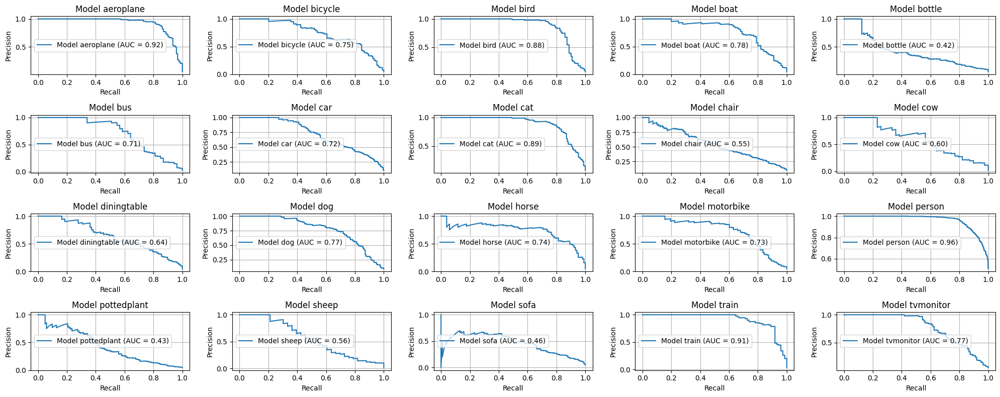

In [ ]:
fig, axs = plt.subplots(4, 5, figsize=(20, 8))
# Flatten the axs array for easy iteration
axs = axs.flatten()

for i, metric in enumerate(metrics):
    p, r = metric['pr']
    auc = metric['auc']
    label = metric['label']

    # Determine the subplot position
    row = i // 5
    col = i % 5

    # Plot on the specified subplot
    axs[i].plot(r, p, label=f'Model {label} (AUC = {auc:.2f})')
    axs[i].set_xlabel('Recall')
    axs[i].set_ylabel('Precision')
    axs[i].set_title(f'Model {label}')
    axs[i].legend(loc='center left')
    axs[i].grid(True)

plt.tight_layout()

# Show the plots
plt.savefig(f'individual_curves.png', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
print("mAP", np.mean([item['auc'] for item in metrics]))

mAP 0.7097596677467158
